In [1]:
import numpy as np
import matplotlib.pyplot as plt
import json
import IPython.display as ipd
from scipy.signal import find_peaks, peak_prominences

from helper import *

plt.rcParams['figure.figsize'] = 10, 5

## Music for DOA Implementation for real data

### Microphone locations

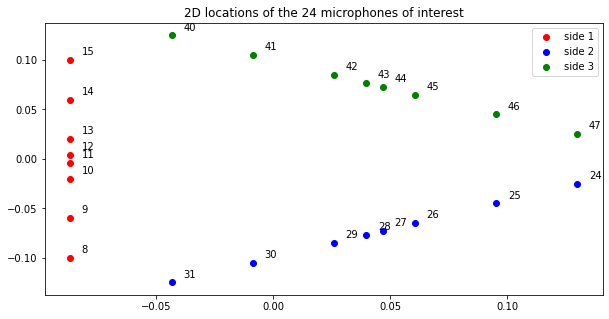

Total 48 microphones,
With 24 microphones on the 2D plane of interest,
at indices : [ 8  9 10 11 12 13 14 15 24 25 26 27 28 29 30 31 40 41 42 43 44 45 46 47]


In [2]:
with open('../data/protocol.json') as json_file:  
    protocol = json.load(json_file)
    
# Load the microphone locations from the pyramic protocol
microphone_3D_locations = np.array(protocol['geometry']['microphones']['locations'])
total_n_mics = len(microphone_3D_locations)

# Retrieve the indices of the microphones located in the same 2D plane as the speaker
is_top_mics = np.isclose(microphone_3D_locations[:, 2], 0.06123724)
n_top_mics = np.sum(is_top_mics)
top_mic_indices = np.arange(total_n_mics)[is_top_mics]

microphone_2D_locations = microphone_3D_locations[is_top_mics, :2]
side1_mic_indices = top_mic_indices[:8]
side2_mic_indices = top_mic_indices[8:16]
side3_mic_indices = top_mic_indices[16:24]

fig, ax = plt.subplots()
ax.scatter(microphone_3D_locations[side1_mic_indices, 0], microphone_3D_locations[side1_mic_indices, 1], color='red', label="side 1")
ax.scatter(microphone_3D_locations[side2_mic_indices, 0], microphone_3D_locations[side2_mic_indices, 1], color='blue', label="side 2")
ax.scatter(microphone_3D_locations[side3_mic_indices, 0], microphone_3D_locations[side3_mic_indices, 1], color='green', label="side 3")
ax.legend()
for i, txt in enumerate(top_mic_indices):
    plt.annotate(txt, (microphone_2D_locations[:, 0][i]+0.005, 
                       microphone_2D_locations[:, 1][i]+0.005))
plt.title(f"2D locations of the {n_top_mics} microphones of interest")
plt.show()

print(f"Total {total_n_mics} microphones,")
print(f"With {n_top_mics} microphones on the 2D plane of interest,")
print(f"at indices : {top_mic_indices}")

### Global parameters

In [3]:
filenames = {
    's3_sp0_20': 'fq_sample3_spkr0_angle20.wav',
    's3_sp0_30': 'fq_sample3_spkr0_angle30.wav',
    's3_sp0_70': 'fq_sample3_spkr0_angle70.wav',
    's1_sp0_20': 'fq_sample1_spkr0_angle20.wav',
    's1_sp0_30': 'fq_sample1_spkr0_angle30.wav',
    's1_sp0_70': 'fq_sample1_spkr0_angle70.wav',
    'sweepco': 'sweep_correlated.wav',
    'speechco': 'speech_correlated.wav',
    'sweepun': 'sweep_uncorrelated.wav',
    'speechun': 'speech_uncorrelated.wav'
}

CHOSEN_SIDE = 1 # Can take value 1, 2, 3, "all"
side_mic_indices = top_mic_indices[(CHOSEN_SIDE-1)*8:CHOSEN_SIDE*8]

# distance of each mic from the position of the first mic, which is used as reference
d = mic_distances(microphone_3D_locations[side_mic_indices, :2])

peak_search_range = np.arange(-90, 90, 1)

In [4]:
def basic_music(X, f, d, D, M):
    # Make sure we have more microphones than input signals
    assert (M > D)

    # Peak search range (start degree, end degree, step)
    peak_search_range = np.arange(-90, 90, 1)
    peak_search_range_len = len(peak_search_range)

    # Compute the wavelength for X
    wavelen = SPEED_OF_SOUND / f

    # Centralize X
    X_mean = np.mean(X, axis=1)
    X_centered = X - np.tile(X_mean, (np.shape(X)[1], 1)).T

    # Covariance matrix
    R = np.dot(X_centered, X_centered.conj().T)

    # Eigen value decomposition
    eig_val, eig_vect = np.linalg.eig(R)

    # Pick the smallest M-D eigen values (corresponding to the noise subspace) and their eigen vectors
    ids = np.abs(eig_val).argsort()[:(M - D)]
    En = eig_vect[:, ids]

    # Noise subspace estimation: Ren = EnEn'
    Ren = np.dot(En, En.conj().T)

    # TODO: explain what this is (it is the matrix gathering every possible directions as columns)
    a_theta = np.exp(-1j * 2 * np.pi / wavelen * np.kron(d, np.sin(peak_search_range / peak_search_range_len * np.pi))
                     .reshape(M, peak_search_range_len))

    # Compute the resulting vector P
    P_MUSIC = np.zeros(peak_search_range_len)
    for j in range(peak_search_range_len):
        P_MUSIC[j] = 1 / abs(np.dot(np.dot(a_theta[:, j].conj().T, Ren), a_theta[:, j]))

    P_MUSIC = np.log(P_MUSIC / np.max(P_MUSIC))
    return P_MUSIC, peak_search_range

### Single-source 

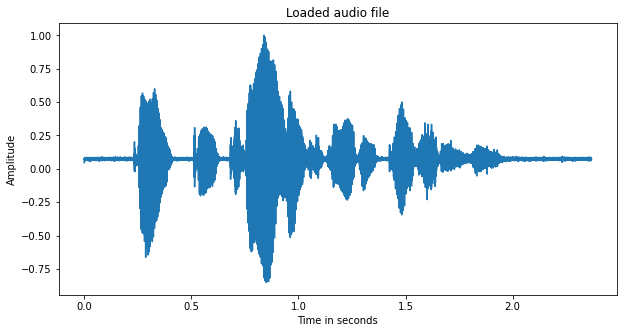

In [5]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("s3_sp0_20", filenames, retrieve_angle=True)
# Add a play button
ipd.Audio(chosen_file_path)

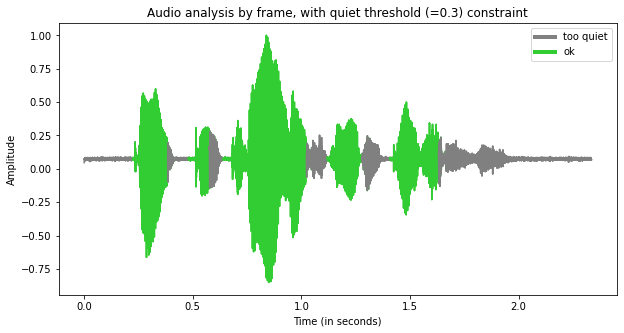

32 frames had a frequency peak in the frequency range: [0, 8000.0] Hz.


In [6]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3, freq_range=None, 
                                                  prominence=0.1)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data)/10)


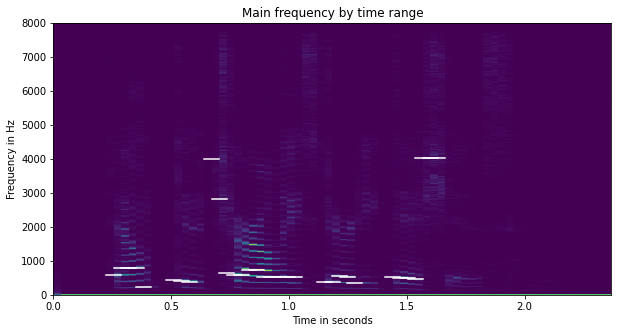

32 valid frames were analysed.
40 frames were discarded because too quiet.


In [7]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [8]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None and len(freqs)>0:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

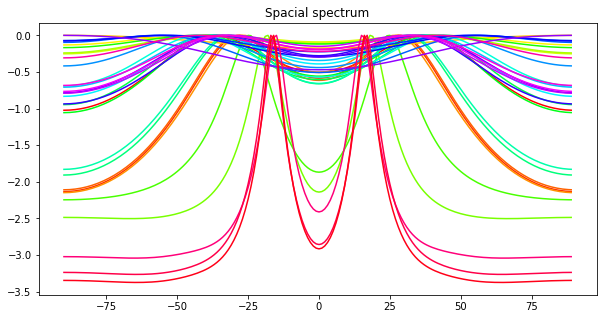

In [9]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

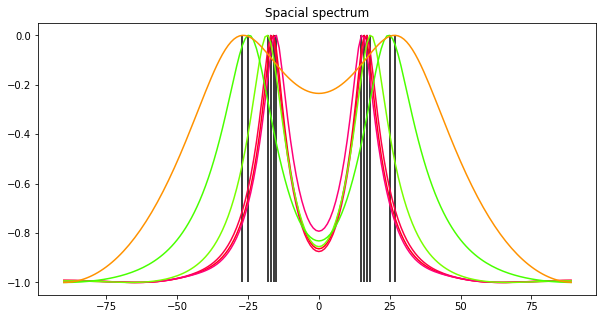

In [10]:
angles_found_array, mean_angle = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=6, prominence=0.5)

In [11]:
print(f"Actual direction of arrival: {directions_of_arrival[0]} degrees")
print(f"Directions found: {angles_found_array}")
print(f"Mean direction found: {mean_angle} degrees")

Actual direction of arrival: 20 degrees
Directions found: [16, 17, 15, 18, 25, 27]
Mean direction found: 19.666666666666668 degrees


The basic algorithm gives two results (one is the opposite of the other), among which is approximately the correct angle we are looking for.
The improved version of the Music for DOA algorithm should correct this issues and improve the slight loss in precision.

### Two sources - correlated

#### Sweep

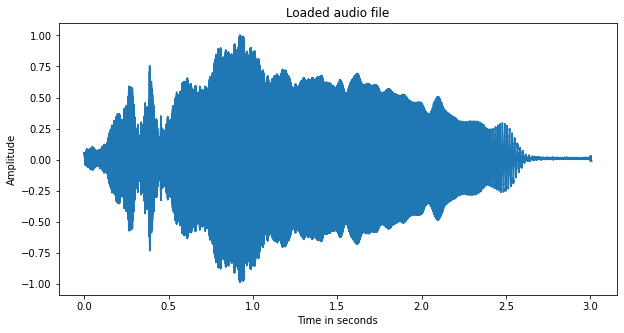

In [12]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("sweepco", filenames)
# Add a play button
ipd.Audio(chosen_file_path)

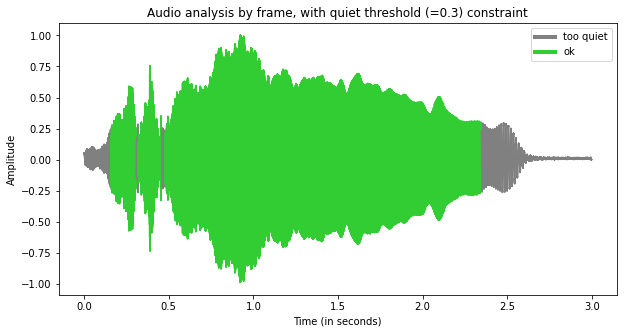

202 frames had a frequency peak in the frequency range: [0, 24000.0] Hz.


In [13]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data)/10)


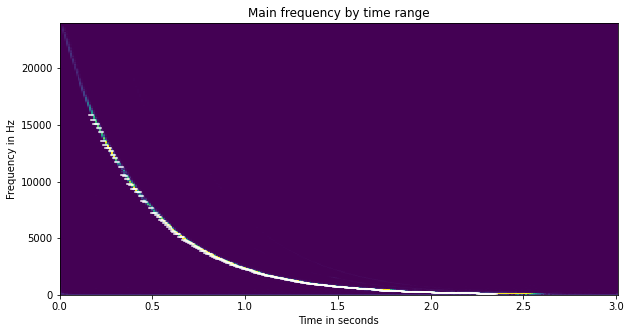

202 valid frames were analysed.
78 frames were discarded because too quiet.


In [14]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [15]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

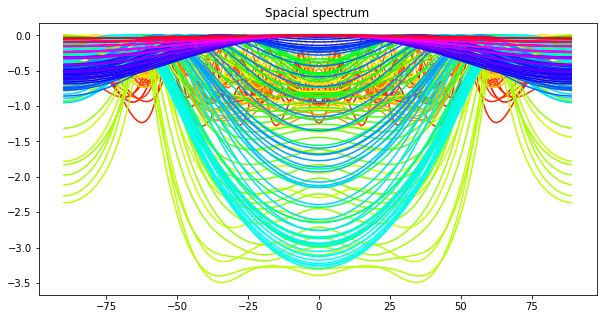

In [16]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

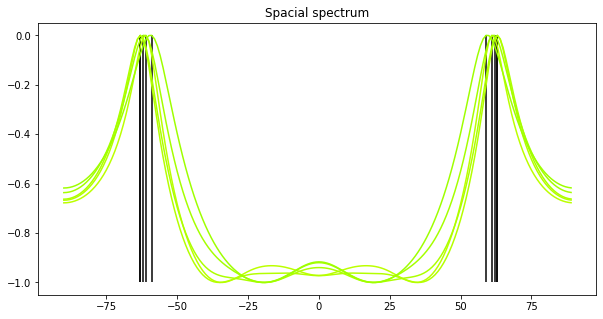

In [17]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=5, prominence=0.5)

In [18]:
print(f"Directions found: {angles_found_array}")

Directions found: [61, 63, 63, 62, 59]


#### Speech

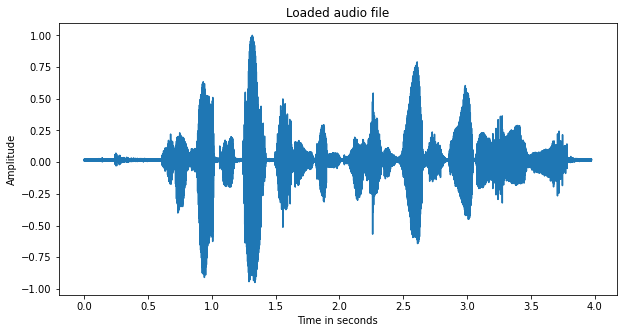

In [19]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("speechco", filenames)
# Add a play button
ipd.Audio(chosen_file_path)

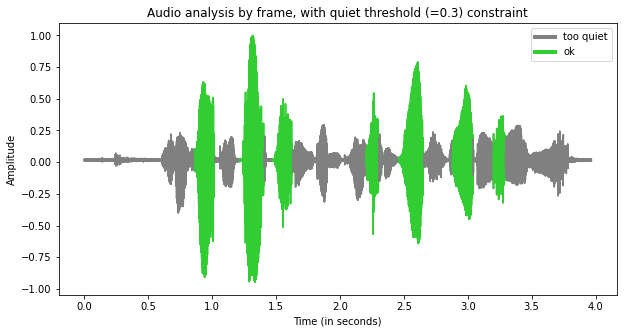

33 frames had a frequency peak in the frequency range: [0, 8000.0] Hz.


In [20]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data)/10)


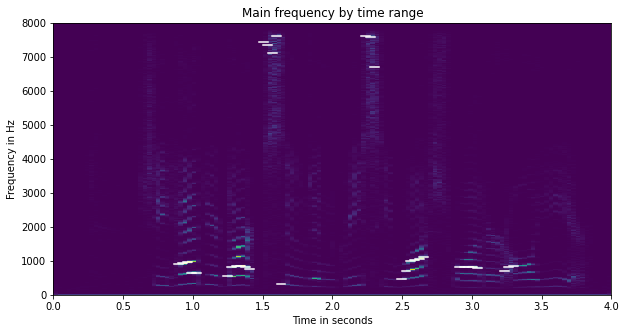

33 valid frames were analysed.
90 frames were discarded because too quiet.


In [21]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [22]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

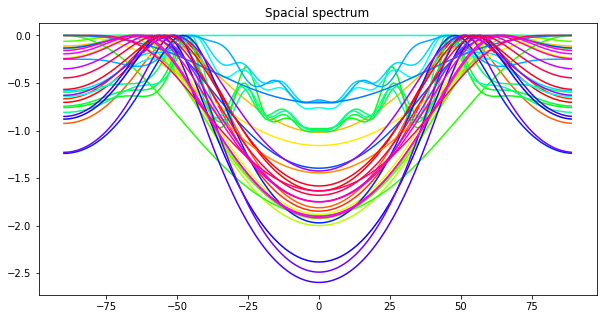

In [23]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

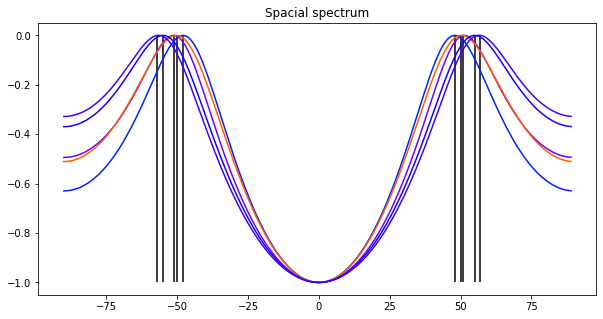

In [24]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=5, prominence=0.5)

In [25]:
print(f"Directions found: {angles_found_array}")

Directions found: [48, 51, 50, 55, 57]


### Two sources - uncorrelated

### Combination of 2 uncorrelated samples with known angles

In [26]:
shortname1 = "s1_sp0_20"
shortname2 = "s3_sp0_30"
chosen_file_path1 = data_path / filenames[shortname1]
chosen_file_path2 = data_path / filenames[shortname2]
angles = [int(shortname1[-2:]), int(shortname2[-2:])]

fs1, data1 = wavfile.read(chosen_file_path1)
fs2, data2 = wavfile.read(chosen_file_path2)
if(len(data1) != len(data2)):
    size_pad = abs(len(data1) - len(data2))
    padding = np.zeros((size_pad, len(data1[0])))
    if(len(data1) > len(data2)):
        data2 = np.concatenate((data2, padding), axis=0)
    else:
        data1 = np.concatenate(data1, padding)
final_data = data1 + data2

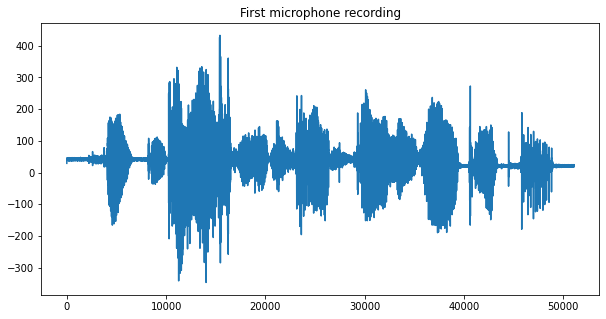

In [27]:
plt.plot(final_data[:, 0])
plt.title("First microphone recording")
plt.show()

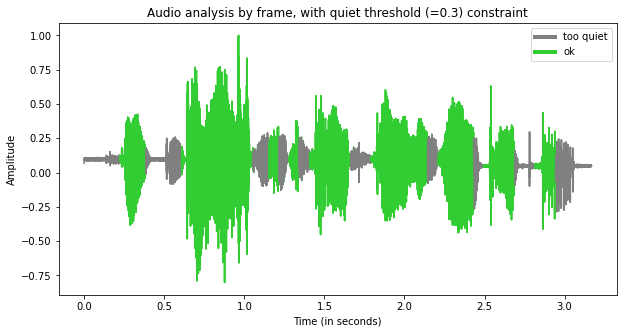

59 frames had a frequency peak in the frequency range: [0, 8000.0] Hz.


In [28]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(final_data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data)/10)


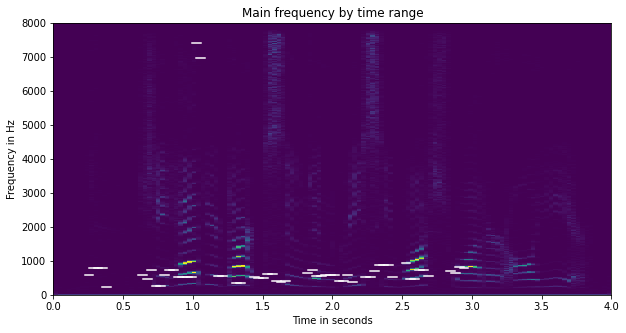

59 valid frames were analysed.
39 frames were discarded because too quiet.


In [29]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [30]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

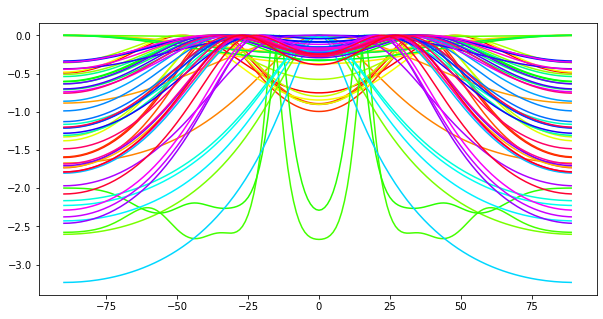

In [31]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

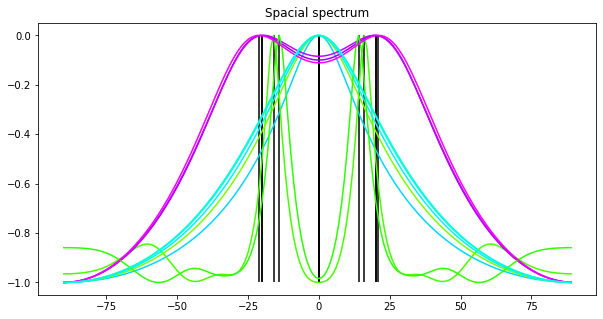

In [32]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=10, prominence=2)

In [33]:
print(f"Directions found: {angles_found_array}")

Directions found: [0, 16, 0, 20, 0, 20, 14, 21, 0, 0]


Peaks are too wide and not prominent enough for a good approximation, and are giving only one angle here.
The improved Music Algorithm should solve this issue.

#### Sweep

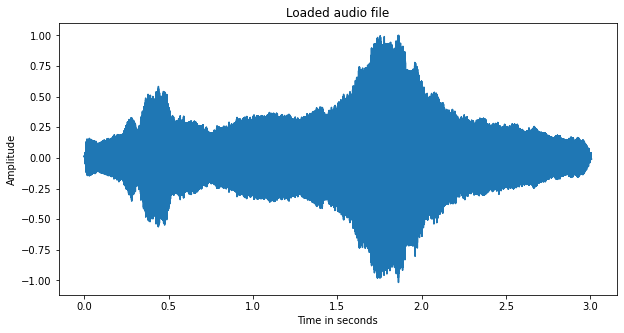

In [34]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("sweepun", filenames)
# Add a play button
ipd.Audio(chosen_file_path)

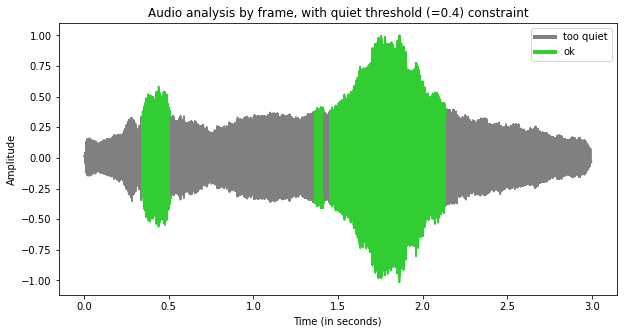

86 frames had a frequency peak in the frequency range: [0, 24000.0] Hz.


In [35]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.4)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data)/10)


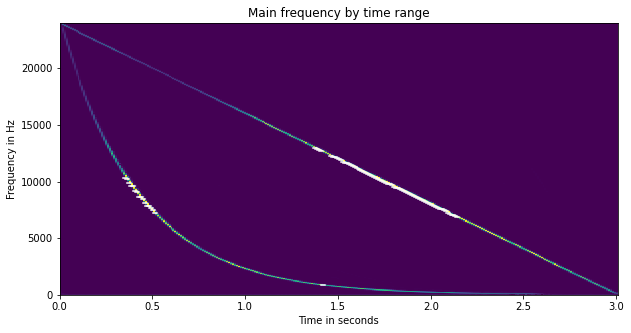

86 valid frames were analysed.
194 frames were discarded because too quiet.


In [36]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [37]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

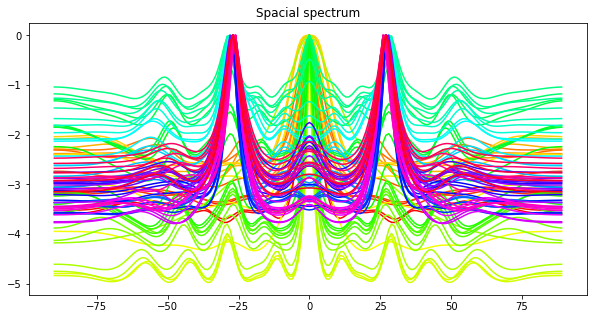

In [38]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

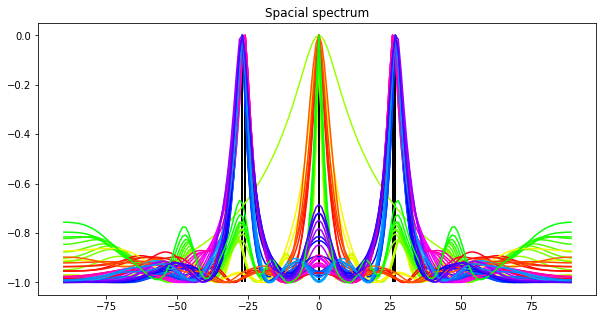

In [39]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=50, prominence=2)

In [40]:
print(f"Directions found: {angles_found_array}")

Directions found: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 27, 27, 0, 0, 27, 27, 27, 0, 26, 26, 0, 26, 27, 26, 27, 27, 0, 0, 27, 27, 27, 0, 27, 27, 27, 27, 26, 27, 27, 27, 27, 0, 27, 27, 27, 0, 27]


### Speech

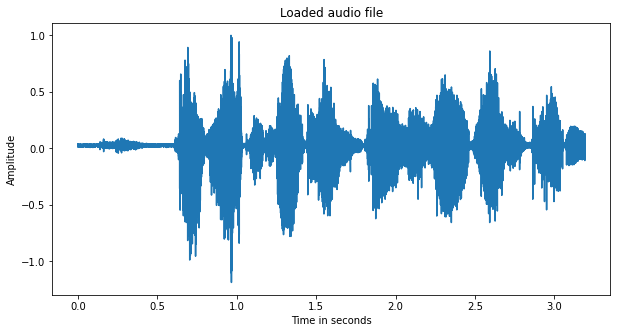

In [41]:
fs, data, directions_of_arrival, chosen_file_path = load_and_plot("speechun", filenames)
# Add a play button
ipd.Audio(chosen_file_path)

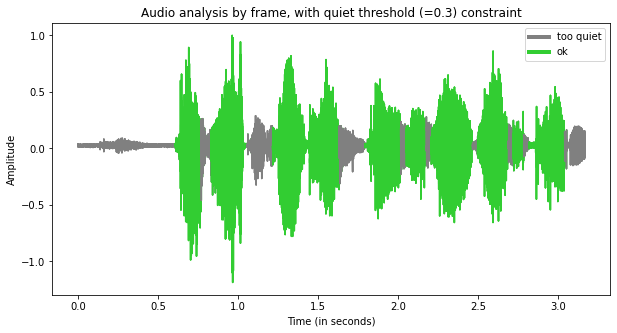

59 frames had a frequency peak in the frequency range: [0, 8000.0] Hz.


In [42]:
n_freqs = 1
X_array, freqs_by_time_range = get_freqs_by_range(data, fs, mic_indices=side_mic_indices, n_freqs=n_freqs, 
                                                  plot=True, quiet_threshold=0.3)

/Users/rayandaod/Documents/EPFL/MA4/SSDP/SSDP_mini-project/notebooks/helper.py:170: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=max(data)/10)


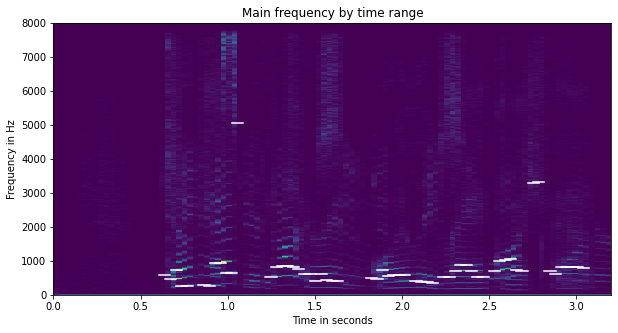

59 valid frames were analysed.
39 frames were discarded because too quiet.


In [43]:
stft_main_freqs(data, fs, freqs_by_time_range)

In [44]:
P_MUSIC_array = []
for i in range(len(freqs_by_time_range)):
    freqs = list(freqs_by_time_range.values())
    freqs = freqs[i]
    if freqs is not None:
        # TODO: add support for n_freqs > 1
        P_MUSIC, _ = basic_music(X_array[i], f=freqs[0], d=d, D=2, M=len(side_mic_indices))
        P_MUSIC_array.append(P_MUSIC)

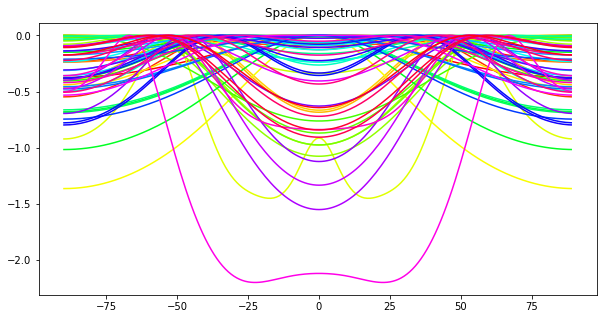

In [45]:
cmap = get_cmap(len(P_MUSIC_array))
for i in range(len(P_MUSIC_array)):
    plt.plot(peak_search_range, P_MUSIC_array[i], c=cmap(i))
    plt.title('Spacial spectrum')
plt.show()

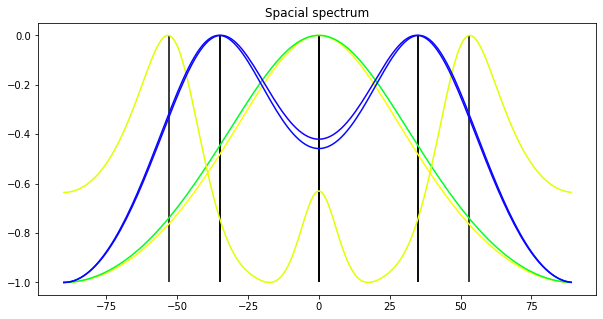

In [46]:
angles_found_array, _ = find_most_prom_peak_index(P_MUSIC_array, peak_search_range, n=5, prominence=0.5)

In [47]:
print(f"Directions found: {angles_found_array}")

Directions found: [0, 0, 53, 35, 35]


We observe that the basic Music for DOA algorithm is (as expected from the previous results) not very precise with correlated data.
We also obtain only one angle for the two sources, which is of course incorrect.